## Cumputer Vision
### Module 3. Object Tracking and Search

Anastasiia Kasprova

Link to Google Colab: https://colab.research.google.com/drive/14Gm1u4Jnt83Pv3cd5NN5SXVotCJmZ1AN

### Task 3.2: Lucas-Kanade Tracking
    
    1.Create a git repository for the project
    2.Implement template-matching in Python using SSD, NCC, SAD + opencv
    3.Code Lucas-Kanade algorithm in Python using OpenCV
    4.Implement pyramidal extension to Lucas-Kanade algorithm
    5.Test on the 3 datasets from http://cvlab.hanyang.ac.kr/tracker_benchmark/datasets.html
    Create a commandline tool in Python that accepts the ROI of the target (the portion of the image that should be tracked in the video) and the path to the dataset and performs tracking of the target over the image sequence from the dataset. Visualize the current image and highlight the target’s location by a rectangle. Find conditions where tracking is lost, explain why.
    
#### References:
    [1] https://docs.opencv.org/trunk/d4/dc6/tutorial_py_template_matching.html
    [2] https://www.ri.cmu.edu/pub_files/pub3/baker_simon_2004_1/baker_simon_2004_1.pdf
    [3] https://www.ripublication.com/ijaer16/ijaerv11n9_06.pdf

#### 3.2.1 Link to github repo:  https://github.com/kasprova/CV_UCU/tree/master/module3/tasks/

-------------------

#### 3.2.2 Template-matching in Python using SSD, NCC, SAD

In [17]:
import cv2 
import numpy as np 
from matplotlib import pyplot as plt
%matplotlib inline
    
def display_image(img, method):
    #plt.figure(figsize=(20,10))
    #plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.imshow(img, cmap = 'gray')
    plt.title(method)
    plt.colorbar()
    plt.show()  

#### My implementation

In [18]:
def SSD(img1, img2):
    """Calculates Sum of Squared Difference / L2 norm"""
    ssd = np.sum((img1-img2)**2) 
    return ssd

def NCC(img1, img2):
    """Calculates Normalized Cross-Correlation"""
    ncc = np.sum((img1*img2))/np.sqrt(np.sum(img1**2)*np.sum(img2**2)) 
    return ncc

def SAD(img1, img2):
    """Calculates Sum of Absolute Difference / L1 norm"""
    sad = np.sum(abs(img1-img2))
    return sad

#**formulas borrowed from:
#https://docs.opencv.org/master/df/dfb/group__imgproc__object.html#gga3a7850640f1fe1f58fe91a2d7583695daf9c3ab9296f597ea71f056399a5831da

In [19]:
# Read frames
fname1 = 'data/Biker/img/0001.jpg'
fname2 = 'data/Biker/img/0005.jpg'
img1_color = cv2.imread(fname1)
img2_color = cv2.imread(fname2)
#convert to gray scale
img1_gray = cv2.cvtColor(img1_color, cv2.COLOR_BGR2GRAY)/255
img2_gray = cv2.cvtColor(img2_color, cv2.COLOR_BGR2GRAY)/255

In [22]:
#select interactively the region of interest on the picture
x,y,w,h = cv2.selectROI(img1_color)
roi = img1_gray[y:y+h, x:x+w]
roi = roi.astype('float32')

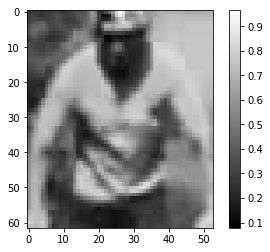

In [23]:
#display what was actually selected
plt.imshow(roi, cmap = 'gray')
plt.colorbar()

In [24]:
def template_match(img_gray, roi, method):
    res = np.ones((img_gray.shape[0]-roi.shape[0],img_gray.shape[1]-roi.shape[1]), np.float32)
    for i in range(res.shape[1]):
        for j in range(res.shape[0]):
            temp = img_gray[j:j+roi.shape[0], i:i+roi.shape[1]]
            res[j][i] = method(roi, temp)
    return res


def draw_rectangle_around_matched_region(fname, template_image, threshold, method):
    last_frame = cv2.imread(fname2)
    
    if method in ["SSD","SAD"]:
        # Store the coordinates of matched area in a numpy array 
        loc = np.where(template_image < threshold)  
    else: 
        loc = np.where(template_image > threshold)  
    # Draw a rectangle around the matched region. 
    for pt in zip(*loc[::-1]): 
        cv2.rectangle(last_frame, pt, (pt[0] + w, pt[1] + h), (0,255,255), 1) 

    # Show the final image with the matched area
    display_image(last_frame,method)
    display_image(template_image,method)

In [25]:
#intialization
ssd_img = template_match(img2_gray, roi, SSD)
ncc_img = template_match(img2_gray, roi, NCC)
sad_img = template_match(img2_gray, roi, SAD)

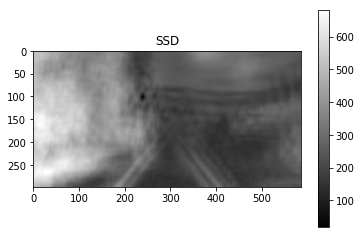

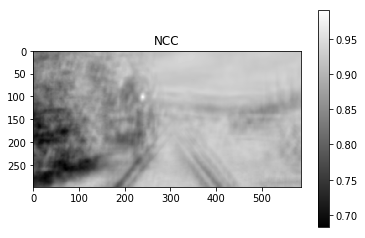

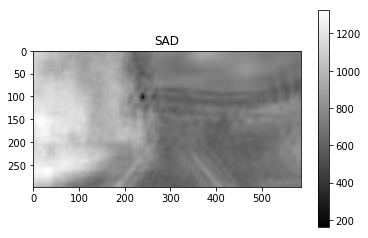

In [26]:
#visualization to select the right threshold
display_image(ssd_img,'SSD')
display_image(ncc_img,'NCC')
display_image(sad_img,'SAD')

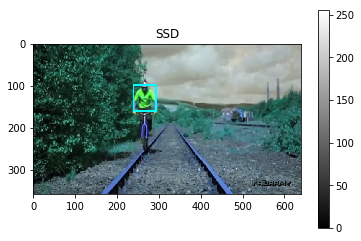

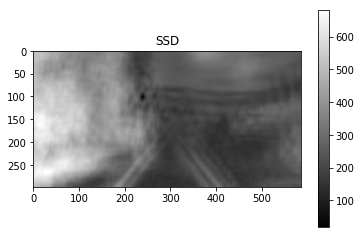

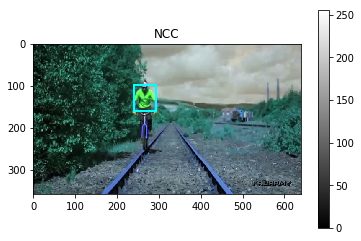

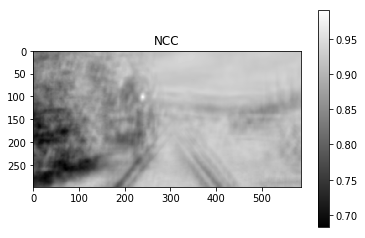

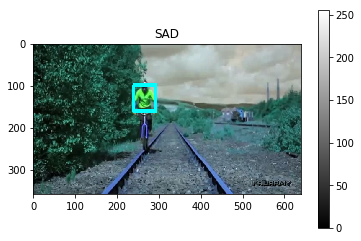

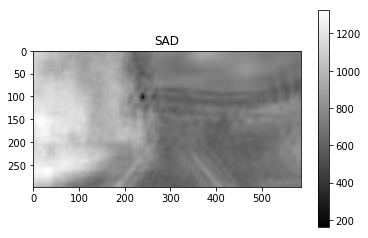

In [27]:
#initialization
draw_rectangle_around_matched_region(fname2, ssd_img, 50, 'SSD')
draw_rectangle_around_matched_region(fname2, ncc_img, 0.97, 'NCC')
draw_rectangle_around_matched_region(fname2, sad_img, 400, 'SAD')

#### Open CV built-in functions

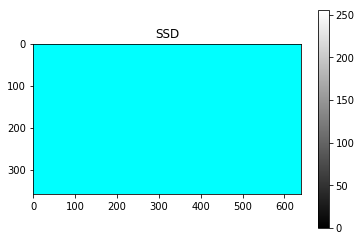

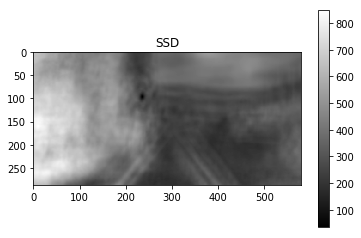

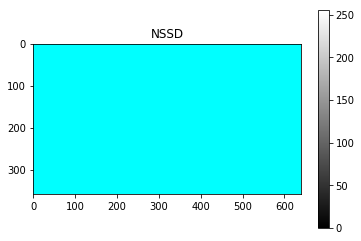

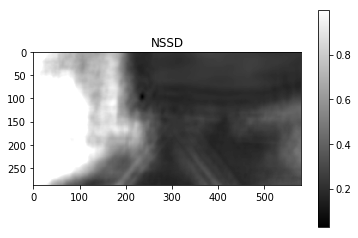

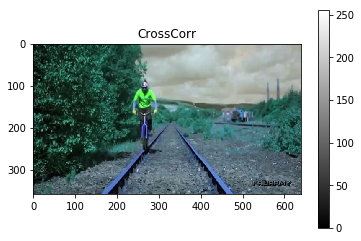

...

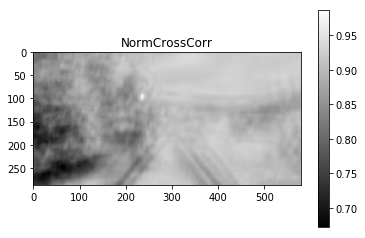

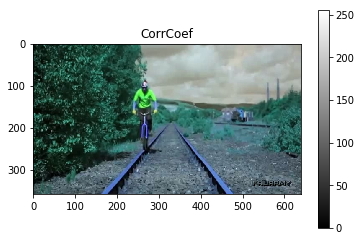

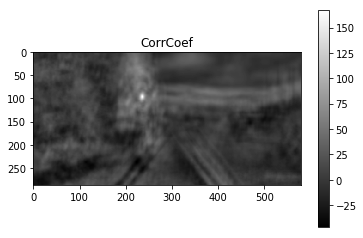

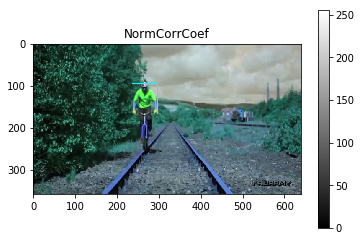

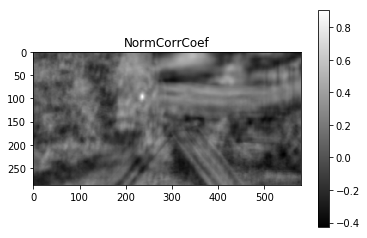

In [28]:
# Read the main image 
fname = 'data/Biker/img/0005.jpg'
img_color = cv2.imread(fname)
img_gray = cv2.cvtColor(img_color, cv2.COLOR_BGR2GRAY)/255
  
# Define the roi (template) from on the initial image
template_color = cv2.imread('data/Biker/img/0001.jpg')
template_gray = cv2.cvtColor(template_color, cv2.COLOR_BGR2GRAY)/255
#x,y,w,h =  242, 92, 58, 8 #data saved from bellow function selectROI
x,y,w,h = cv2.selectROI(template_gray)
roi = template_gray[y:y+h, x:x+w]
roi = roi.astype('float32')
img_gray = img_gray.astype('float32')

#testing matching methods available in opencv
matching_methods = (
    ("SSD", cv2.TM_SQDIFF,-0.01), #Sum of Squared Difference
    ("NSSD", cv2.TM_SQDIFF_NORMED,-0.01), #Normalized Sum of Squared Difference
    ("CrossCorr", cv2.TM_CCORR, 1850), #Cross-Correlation
    ("NormCrossCorr", cv2.TM_CCORR_NORMED, 0.98), #Normalized Cross-Correlation  
    ("CorrCoef", cv2.TM_CCOEFF, 190), #Correlation Coefficient
    ("NormCorrCoef", cv2.TM_CCOEFF_NORMED, 0.9) #Normalized Correlation Coefficient
)
 
# loop over the comparison methods
for (methodName, method, threshold) in matching_methods:
    #read image
    img = cv2.imread(fname)
    
    # Perform match operations: 
    res = cv2.matchTemplate(img_gray,roi,method) 
    
    if method in ["SSD","NSSD"]:
        # Store the coordinates of matched area in a numpy array 
        loc = np.where(res <= threshold)  
    else: 
        loc = np.where(res >= threshold)
  
    # Draw a rectangle around the matched region. 
    for pt in zip(*loc[::-1]): 
        cv2.rectangle(img, pt, (pt[0] + w, pt[1] + h), (0,255,255), 1) 

    # Show the final image with the matched area
    display_image(img,methodName)
    display_image(res,methodName)

#### Comments: 
To choose the right threshold one should check the visualization first (still not easy)

-----------------------

### 3.2.3 Lucas-Kanade algorithm in Python (non pyramidal)

#### Lucas-Kanade Algorithm:

    Iterate:
(1) Warp $I$ with $W(x,p)$ to compute $I(W(x,p))$ 

(2) Compute the error image $T(x) - I(W(x,p))$

(3) Warp the gradient $\nabla I$ with $W(x,p)$

(4) Evaluate the Jacobian $\frac{\partial W}{\partial p}$ at $((x,y),p)$

(5) Compute steepest descent images: $\nabla I \frac{\partial W}{\partial p}$

(6) Compute Hessian matrix: 
$\sum[\nabla I\frac{\partial W}{\partial p}]^{T}[\nabla I\frac{\partial W}{\partial p}]$

(7) Compute $\sum[\nabla I\frac{\partial W}{\partial p}]^{T}[T(x) - I(W(x,p))]$

(8) Compute $dp$

(9) Update $p := p + dp$
    

    Until $dp$ magnitude is negligible

In [1]:
import numpy as np
import cv2
import glob
from matplotlib import pyplot as plt
%matplotlib inline

In [2]:
def get_template(img, roi):
    """
    Crop the image based on region of interest (roi)
    Input: 
        img - image
        roi - region of interest: x,y,w,h
    Output:
        copped image
    """
    x,y,w,h = roi
    template = img[y:y+h,x:x+w]
    return template

In [3]:
def get_central_point(roi):
    """
    Input:
        roi - region of interest: x,y,w,h
    Output:
        central point of the region of interest: x,y coordinate
    """
    x0,y0 = roi[0]+roi[2]//2, roi[1]+roi[3]//2
    return np.array([x0,y0],np.float32)

In [4]:
def get_roi(central_point, w, h):
    """
    Return roi based on central point (x0,y0) coordinates, width and heigh
    """
    x0,y0 = central_point
    x = x0-w//2
    y = y0-h//2
    return np.array([x,y,w,h],np.int32)

In [5]:
def jacobian(x, method = 'affine'):
    """
    Return Jacobian (dW_dp)
    if method = 'affine' (tracking)
    dW/dP = |x 0 y 0 1 0|
            |0 x 0 y 0 1|
    if method = 'opticflow'
    dW/dP = |1 0 0 0 0 0|
            |0 1 0 0 0 0|
    """
    if method == 'affine':
        dW_dp = [[x[0], 0, x[1], 0, 1, 0],
            [0, x[0], 0, x[1], 0, 1]]
    
    elif method == 'opticflow':
        dW_dp = [[1, 0, 0, 0, 0, 0],
            [0, 1, 0, 0, 0, 0]]
    
    return dW_dp

In [6]:
def warp_affine(img, p): 
    """
    Warp I with W(x,p) to compute I*W(x,p)
    Input: 
        img - gray-scaled image
        p - vector of parameters: p = (p1,p2,p3,p4,p5,p6)^T 
    """
    affine_transform = np.array([[1+p[0], p[2], p[4]],
                                [p[1], 1+p[3], p[5]]], np.float32)
    if len(img.shape)==2:
        I_W = cv2.warpAffine(img, affine_transform, (img.shape[::-1]))
    elif len(img.shape)==1:
        vec = np.array([img[0],img[1],1],np.float32).T
        I_W = np.dot(affine_transform,vec)
    return I_W

In [7]:
def hessian_approximation(steepest_descent_images):
    """
    H - nxn matrix, Gauss-Newton approximation to the Hessian matrix
    H = [grad(I)*dW/dp]^T*[grad(I)*dW/dp]
        where grad(I)*dW/dp - steepest_descent_images
    """
    H = np.dot(steepest_descent_images.T, steepest_descent_images)
    return H

In [8]:
def show_rectangle_on_image(img, roi, title):
    x,y,w,h = roi
    cv2.rectangle(img = img, 
                         pt1 = (x,y), #vertex of rectangle
                         pt2 = (x+w,y+h), #vertex of opposite to pt1
                         color = (0,255,255), #yellow
                         thickness = 2),
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.show()

In [17]:
def lukas_kanade_tracker(path_to_folder):
    #parameters:
    num_iterations = 100
    eps = 0.001
    p = np.zeros(6, np.float32)
    
    #read images from dataset
    filenames = glob.glob(path_to_folder+"*.jpg")
    
    #select the initial roi on the fisrt frame
    first_frame_color = cv2.imread(filenames[0])
    first_frame = cv2.cvtColor(first_frame_color, cv2.COLOR_RGB2GRAY)
    
    roi = cv2.selectROI(first_frame_color) 
    cv2.destroyAllWindows()
    show_rectangle_on_image(first_frame_color,roi,filenames[0])
    
    #find central point of roi
    central_point = get_central_point(roi)
    #define a template
    template = get_template(first_frame,roi)

    #read images from dataset
    filenames = glob.glob(path_to_folder+"*.jpg")


    for index, fpath in enumerate(filenames):
        frame_color = cv2.imread(fpath)
        frame = cv2.cvtColor(frame_color, cv2.COLOR_RGB2GRAY)
        for i in range(num_iterations):
            #1 Warp I with W(x,p) to compute I(W(x,p))
            I_W = warp_affine(frame, p)

            #2 Compute the error image T(x)−I(W(x,p))
            I_W_cropped = get_template(I_W, roi)
            error_image = np.subtract(template,I_W_cropped, dtype='float64')
            #reshape error_image
            error_image = np.tile(error_image.flatten(), (len(p), 1)).T

            #3 Warp the gradient ∇I with W(x,p)
            # apply Sobel operator to find derivatives of I
            dI_dx = cv2.Sobel(frame, cv2.CV_64F, 1, 0, ksize=3)
            dI_dy = cv2.Sobel(frame, cv2.CV_64F, 0, 1, ksize=3)
            # warp derivatives with W
            dI_dx_W = warp_affine(dI_dx, p)
            dI_dy_W = warp_affine(dI_dy, p)
            # crop
            dI_dx_W = get_template(dI_dx_W, np.int32(roi))
            dI_dy_W = get_template(dI_dy_W, np.int32(roi))
            # gradient I
            grad_I = np.array([dI_dx_W.flatten(), dI_dy_W.flatten()], np.float32).T


            X, Y = np.meshgrid(range(template.shape[0]), range(template.shape[1]))
            coordinates_2d = np.array([X.flatten(), Y.flatten()]).T

            #5 Compute steepest descent images: ∇I*∂W/∂p
            steepest_descent_image = []
            for i in range(grad_I.shape[0]):
                #4 Evaluate the Jacobian ∂W/∂p at ((x,y),p)
                dW_dp = jacobian(coordinates_2d[i])
                steepest_descent_image.append(np.dot(grad_I[i],dW_dp))
            steepest_descent_image = np.array(steepest_descent_image, np.float32)

            #6 Compute Hessian matrix (Gauss-Newton approximation): ∑[∇I*∂W/∂p]^T[∇I*∂W/∂p]
            H = hessian_approximation(steepest_descent_image)

            #7 Compute cost function: ∑[∇I*∂W/∂p]^T[T(x)−I(W(x,p))]
            cost_function = np.sum(steepest_descent_image*error_image, axis=0)

            #8 Compute dp: inv(H)*cost_function
            dp = np.dot(np.linalg.inv(H),cost_function.T) #8

            #Calculate ||dp||
            dp_norm = np.linalg.norm(dp) #9
            #until ||dp||<=eps
            if dp_norm <= eps:
                break
            else: 
                #Update parameter: `p=p+dp
                p += dp.T

        #updates
        central_point = warp_affine(central_point, p)
        roi = get_roi(central_point,w=roi[2],h=roi[3])
        template = get_template(frame,roi)

        #vizualization
        show_rectangle_on_image(frame_color,roi,fpath)

    cv2.destroyAllWindows()

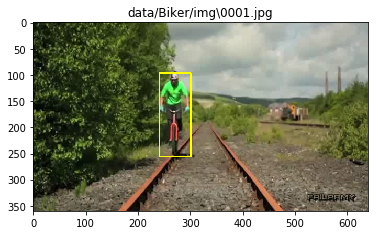

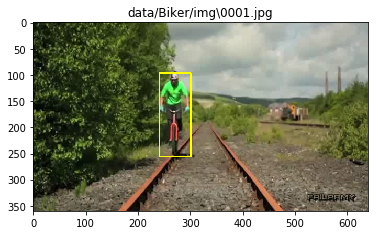

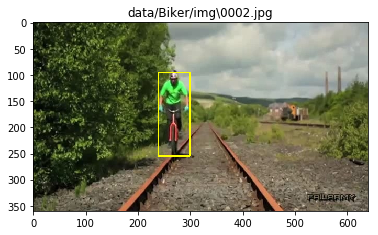

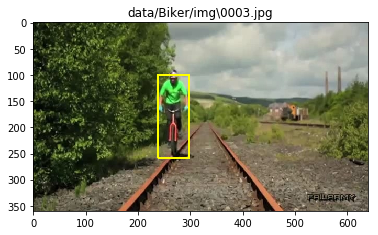

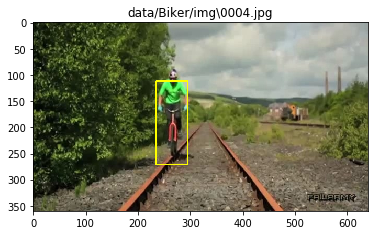

...

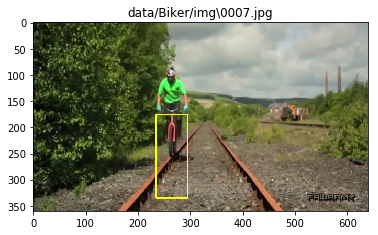

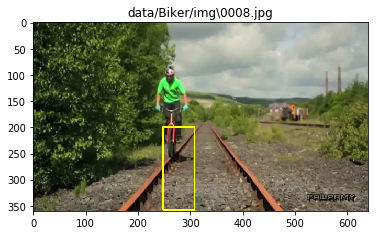

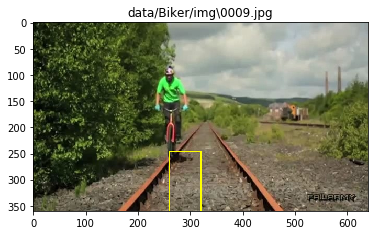

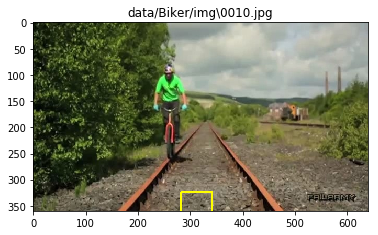

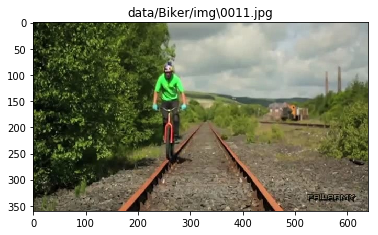

ValueError: operands could not be broadcast together with shapes (0,) (0,6) 

In [10]:
#initialization
lukas_kanade_tracker(path_to_folder = 'data/Biker/img/')

#### Reference:
https://www.ri.cmu.edu/pub_files/pub3/baker_simon_2004_1/baker_simon_2004_1.pdf

----------

### 3.2.4 Lucas-Kanade Algorithm with image pyramids (opencv using good features to track)

In [4]:
#using dataset as a source 
import numpy as np
import cv2
import glob
from matplotlib import pyplot as plt
%matplotlib inline


def display_image(img, index):
    #plt.figure(figsize=(20,10))
    plt.figure(index)
    plt.title(index)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.show()


def lucas_kanade_opticalflow_opencv(path_to_folder):
    #read images from dataset
    filenames = glob.glob(path_to_folder+"*.jpg")
    

    # params for ShiTomasi corner detection
    feature_params = dict( maxCorners = 500,
                           qualityLevel = 0.3,
                           minDistance = 5,
                           blockSize = 7 )
    # Parameters for lucas kanade optical flow
    lk_params = dict( winSize  = (15,15),
                      maxLevel = 2,
                      criteria = (cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03))
    # Create some random colors
    color = np.random.randint(0,255,(100,3))
    # Take first frame and find corners in it
    old_frame = cv2.imread(filenames[0])
    old_gray = cv2.cvtColor(old_frame, cv2.COLOR_BGR2GRAY)
    p0 = cv2.goodFeaturesToTrack(old_gray, mask = None, **feature_params)
    # Create a mask image for drawing purposes
    mask = np.zeros_like(old_frame)


    for index, fpath in enumerate(filenames[:50]):
        frame = cv2.imread(fpath)
        frame_gray = cv2.cvtColor(frame, cv2.COLOR_RGB2GRAY)
        # calculate optical flow
        p1, st, err = cv2.calcOpticalFlowPyrLK(old_gray, frame_gray, p0, None, **lk_params)
        # Select good points
        good_new = p1[st==1]
        good_old = p0[st==1]
        # draw the tracks
        for i,(new,old) in enumerate(zip(good_new, good_old)):
            a,b = new.ravel()
            c,d = old.ravel()
            mask = cv2.line(mask, (a,b),(c,d), color[i].tolist(), 2)
            frame = cv2.circle(frame,(a,b),5,color[i].tolist(),-1)
        img = cv2.add(frame,mask)
        display_image(img,index)

        # Now update the previous frame and previous points
        old_gray = frame_gray.copy()

        p0 = good_new.reshape(-1,1,2)


    cv2.destroyAllWindows()

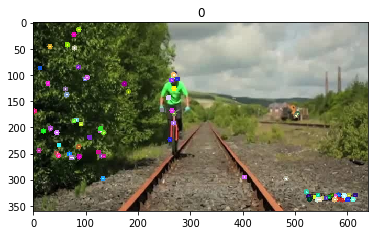

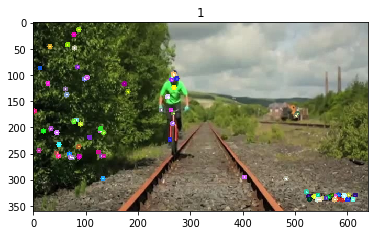

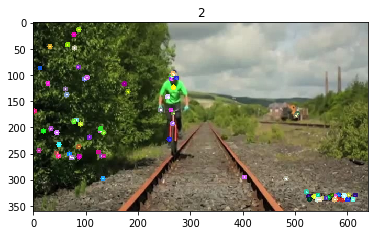

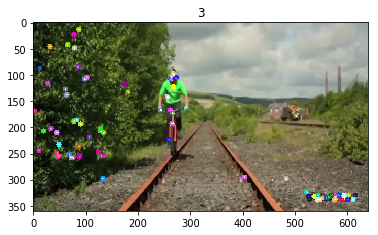

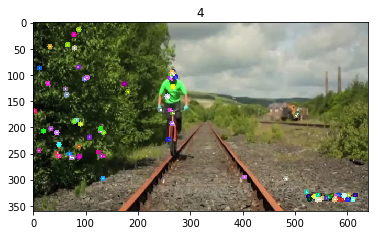

...

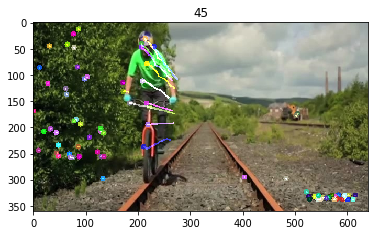

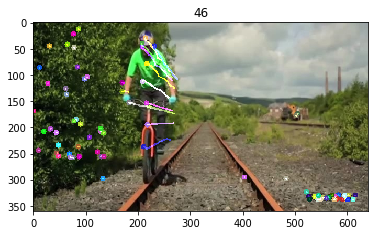

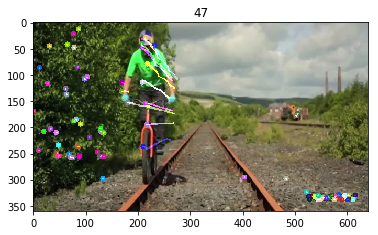

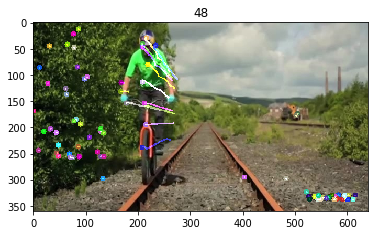

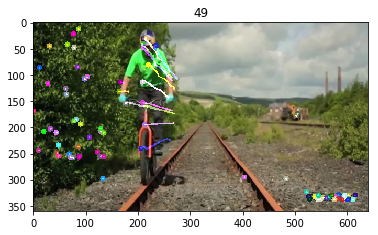

In [5]:
#initialization
lucas_kanade_opticalflow_opencv(path_to_folder = 'data/Biker/img/')

#### References:
1. https://github.com/opencv/opencv/tree/master/samples/python

----------

#### 3.2.5 Testing 3 more datasets with LK tracker (3.2.3)

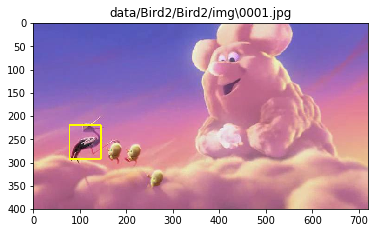

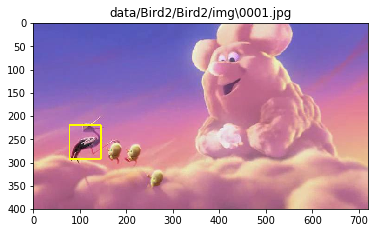

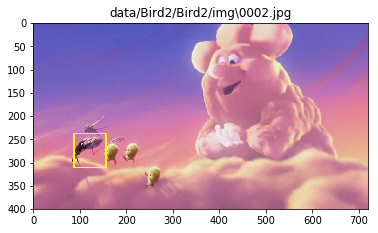

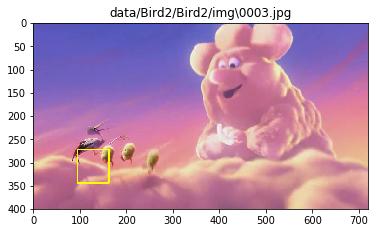

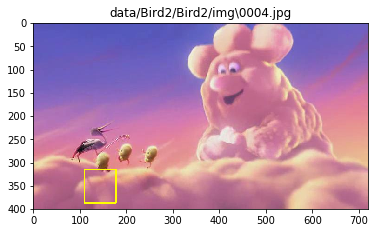

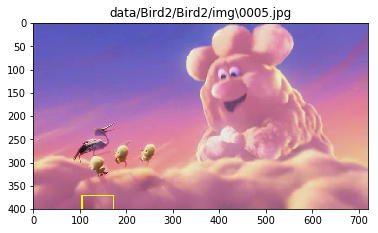

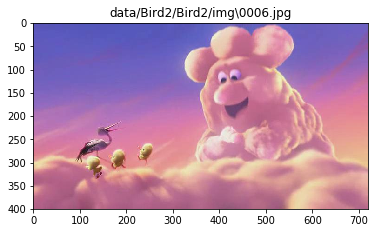

ValueError: operands could not be broadcast together with shapes (0,) (0,6) 

In [10]:
#initialization
lukas_kanade_tracker(path_to_folder = 'data/Bird2/Bird2/img/')

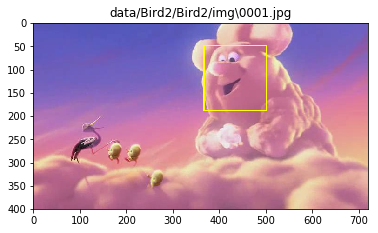

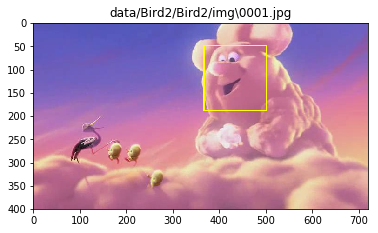

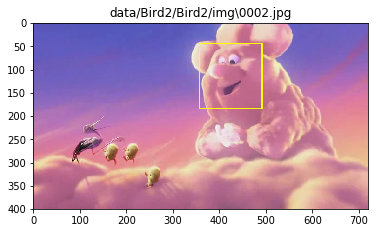

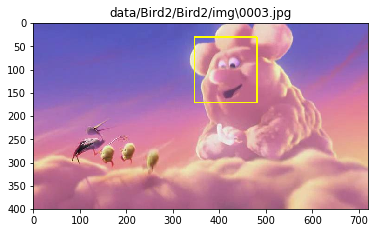

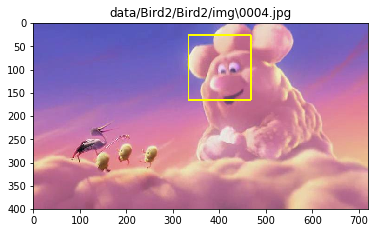

...

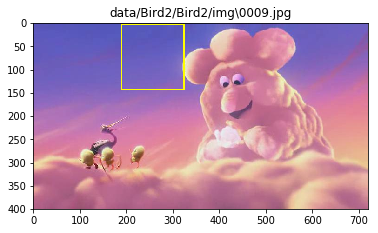

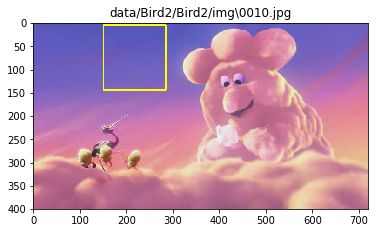

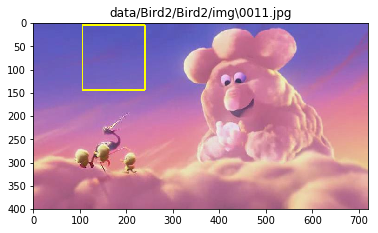

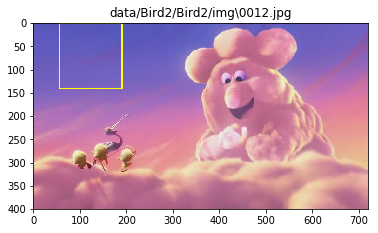

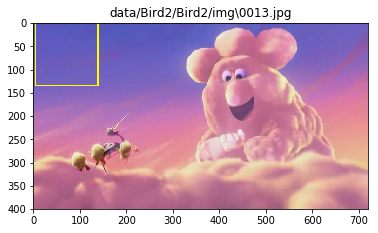

ValueError: operands could not be broadcast together with shapes (0,) (0,6) 

In [11]:
lukas_kanade_tracker(path_to_folder = 'data/Bird2/Bird2/img/')

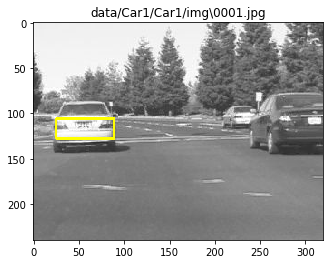

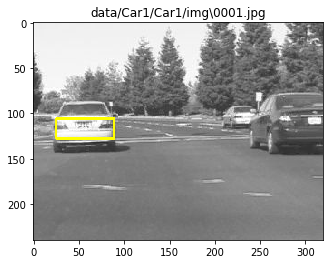

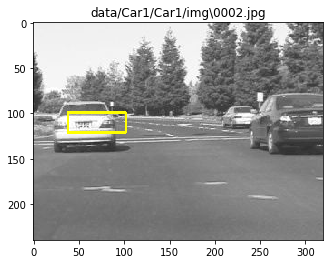

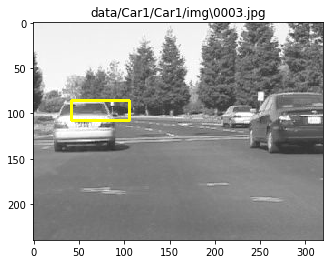

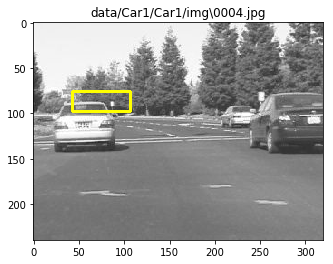

...

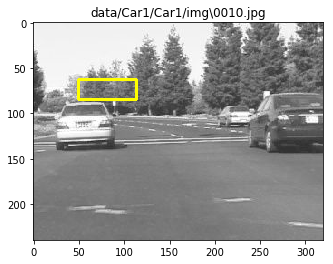

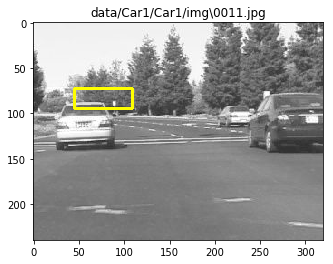

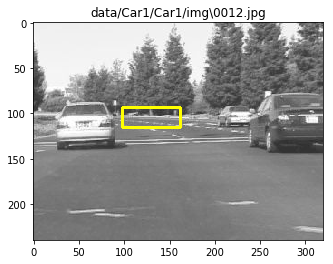

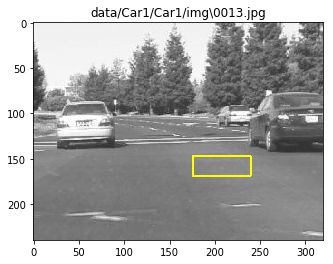

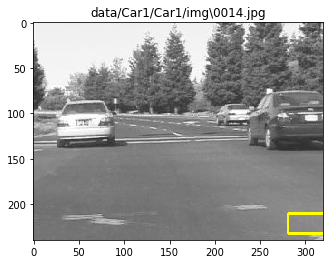

LinAlgError: Singular matrix

In [15]:
lukas_kanade_tracker(path_to_folder = 'data/Car1/Car1/img/')

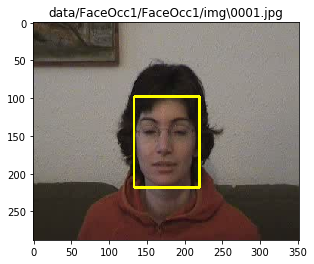

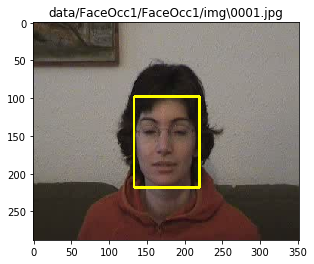

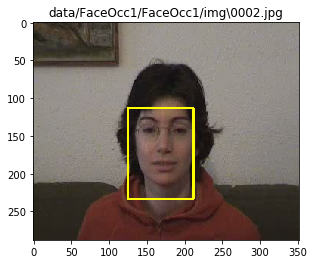

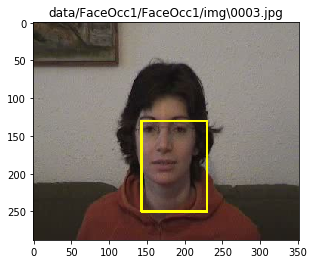

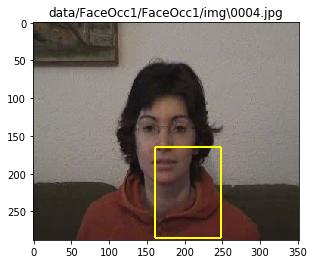

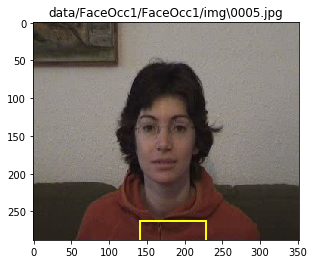

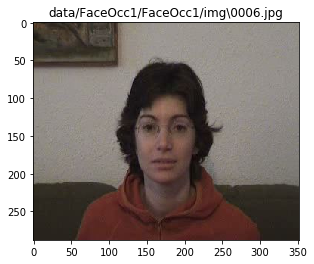

ValueError: operands could not be broadcast together with shapes (0,) (0,6) 

In [18]:
lukas_kanade_tracker(path_to_folder = 'data/FaceOcc1/FaceOcc1/img/')

#### Testing 3 more datasets with LK built-in opencv(3.2.4)

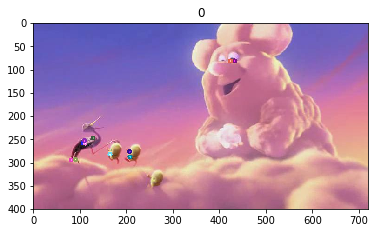

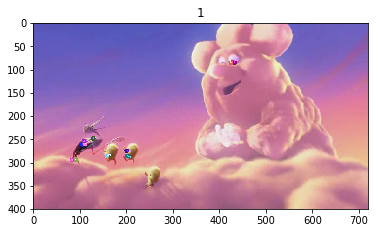

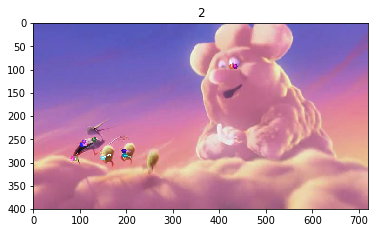

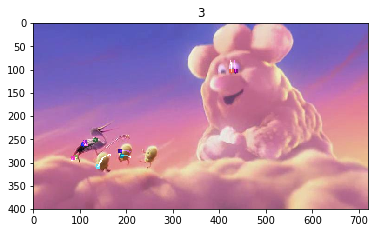

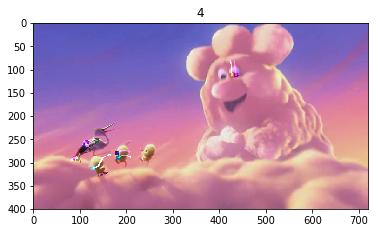

...

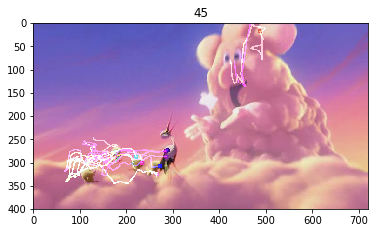

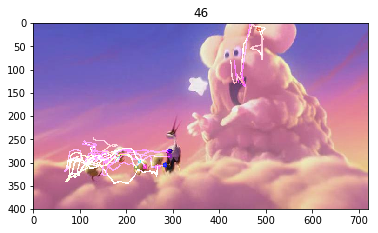

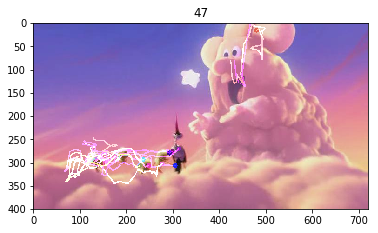

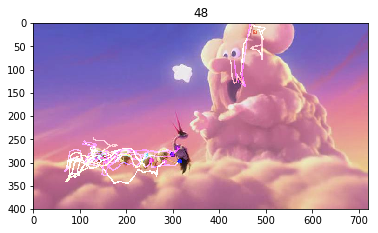

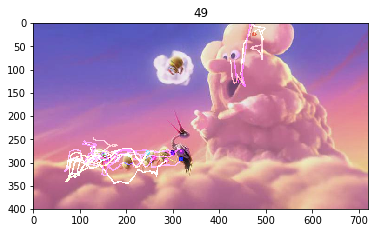

In [6]:
lucas_kanade_opticalflow_opencv(path_to_folder = 'data/Bird2/Bird2/img/')

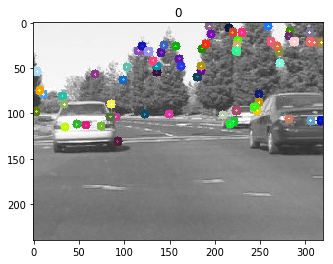

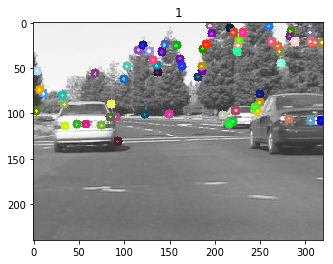

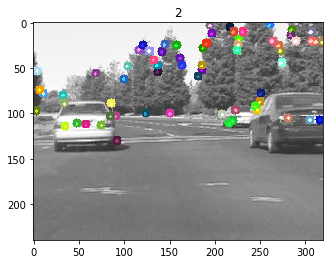

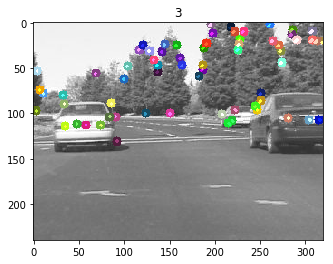

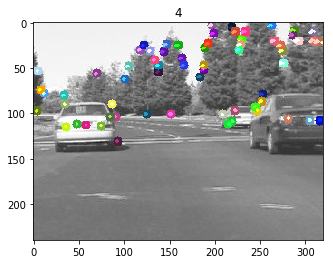

...

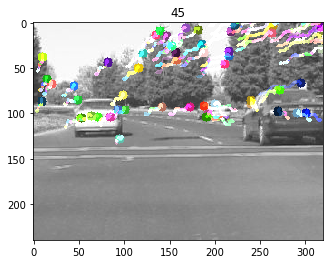

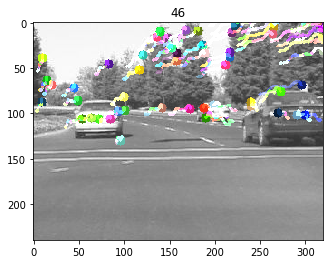

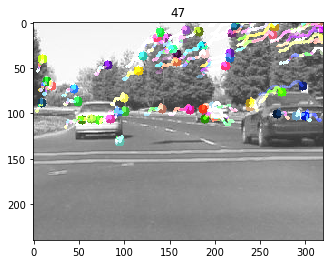

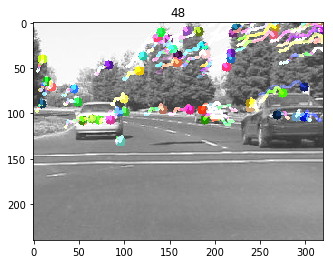

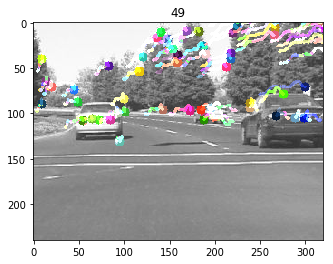

In [7]:
lucas_kanade_opticalflow_opencv(path_to_folder = 'data/Car1/Car1/img/')

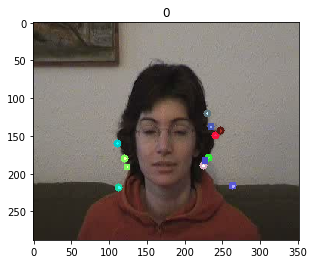

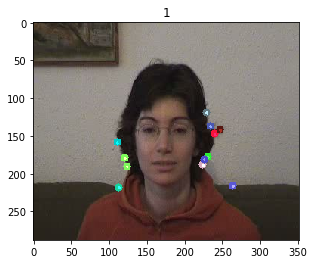

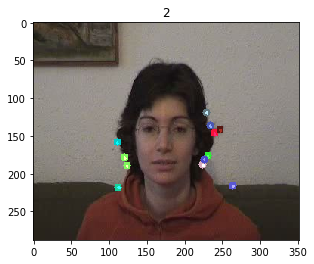

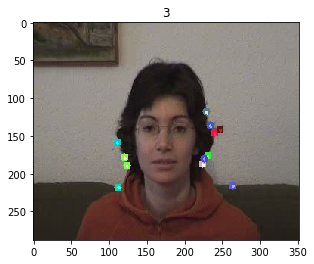

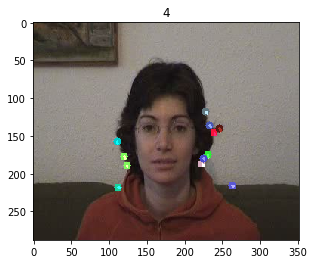

...

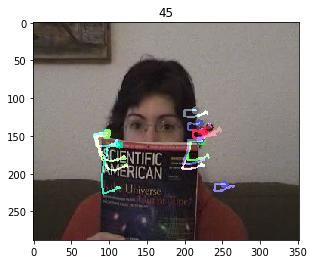

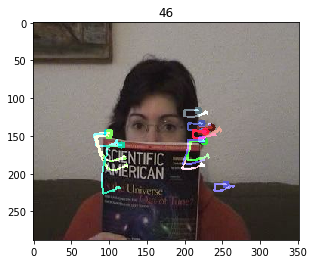

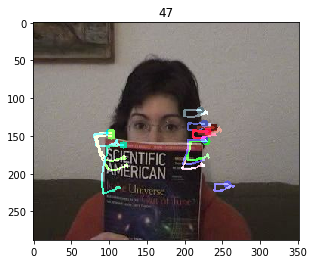

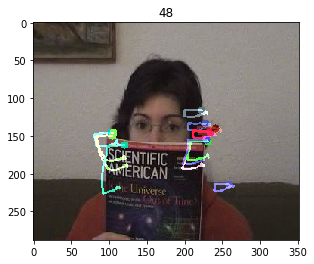

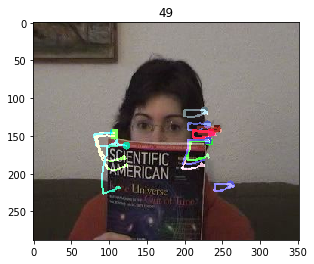

In [2]:
lucas_kanade_opticalflow_opencv(path_to_folder = 'data/FaceOcc1/FaceOcc1/img/')

-----

### Comments:
Overall Lucas-Kanade algorithm implemented by me shows weird behavior. It was tested with diferent values of eps and number of iterations as well as dataset. Its meaningful life time value does not exceed 10 first trames. Moreover, the wellness of the tracker very sensative the initial roi selected